<!-- Notebook title -->
# Title

# 1. Notebook Description

### 1.1 Task Description
<!-- 
- A brief description of the problem you're solving with machine learning.
- Define the objective (e.g., classification, regression, clustering, etc.).
-->

TODO

### 1.2 Useful Resources
<!--
- Links to relevant papers, articles, or documentation.
- Description of the datasets (if external).
-->

### 1.2.1 Data

#### 1.2.1.1 Common

* [Datasets Kaggle](https://www.kaggle.com/datasets)  
  &nbsp;&nbsp;&nbsp;&nbsp;A vast repository of datasets across various domains provided by Kaggle, a platform for data science competitions.
  
* [Toy datasets from Sklearn](https://scikit-learn.org/stable/datasets/toy_dataset.html)  
  &nbsp;&nbsp;&nbsp;&nbsp;A collection of small datasets that come with the Scikit-learn library, useful for quick prototyping and testing algorithms.
  
* [UCI Machine Learning Repository](https://archive.ics.uci.edu/ml/index.php)  
  &nbsp;&nbsp;&nbsp;&nbsp;A widely-used repository for machine learning datasets, with a variety of real-world datasets available for research and experimentation.
  
* [Google Dataset Search](https://datasetsearch.research.google.com/)  
  &nbsp;&nbsp;&nbsp;&nbsp;A tool from Google that helps to find datasets stored across the web, with a focus on publicly available data.
  
* [AWS Public Datasets](https://registry.opendata.aws/)  
  &nbsp;&nbsp;&nbsp;&nbsp;A registry of publicly available datasets that can be analyzed on the cloud using Amazon Web Services (AWS).
  
* [Microsoft Azure Open Datasets](https://azure.microsoft.com/en-us/services/open-datasets/)  
  &nbsp;&nbsp;&nbsp;&nbsp;A collection of curated datasets from various domains, made available by Microsoft Azure for use in machine learning and analytics.
  
* [Awesome Public Datasets](https://github.com/awesomedata/awesome-public-datasets)  
  &nbsp;&nbsp;&nbsp;&nbsp;A GitHub repository that lists a wide variety of datasets across different domains, curated by the community.
  
* [Data.gov](https://www.data.gov/)  
  &nbsp;&nbsp;&nbsp;&nbsp;A portal to the US government's open data, offering access to a wide range of datasets from various federal agencies.
  
* [Google BigQuery Public Datasets](https://cloud.google.com/bigquery/public-data)  
  &nbsp;&nbsp;&nbsp;&nbsp;Public datasets hosted by Google BigQuery, allowing for quick and powerful querying of large datasets in the cloud.
  
* [Papers with Code](https://paperswithcode.com/datasets)  
  &nbsp;&nbsp;&nbsp;&nbsp;A platform that links research papers with the corresponding code and datasets, helping researchers reproduce results and explore new data.
  
* [Zenodo](https://zenodo.org/)  
  &nbsp;&nbsp;&nbsp;&nbsp;An open-access repository that allows researchers to share datasets, software, and other research outputs, often linked to academic publications.
  
* [The World Bank Open Data](https://data.worldbank.org/)  
  &nbsp;&nbsp;&nbsp;&nbsp;A comprehensive source of global development data, with datasets covering various economic and social indicators.
  
* [OpenML](https://www.openml.org/)  
  &nbsp;&nbsp;&nbsp;&nbsp;An online platform for sharing datasets, machine learning experiments, and results, fostering collaboration in the ML community.
  
* [Stanford Large Network Dataset Collection (SNAP)](https://snap.stanford.edu/data/)  
  &nbsp;&nbsp;&nbsp;&nbsp;A collection of large-scale network datasets from Stanford University, useful for network analysis and graph-based machine learning.
  
* [KDnuggets Datasets](https://www.kdnuggets.com/datasets/index.html)  
  &nbsp;&nbsp;&nbsp;&nbsp;A curated list of datasets for data mining and data science, compiled by the KDnuggets community.


#### 1.2.1.2 Project

### 1.2.2 Learning

* [K-Nearest Neighbors on Kaggle](https://www.kaggle.com/code/mmdatainfo/k-nearest-neighbors)

* [Complete Guide to K-Nearest-Neighbors](https://kevinzakka.github.io/2016/07/13/k-nearest-neighbor)

### 1.2.3 Documentation

---

# 2. Setup

## 2.1 Imports
<!--
- Import necessary libraries (e.g., `numpy`, `pandas`, `matplotlib`, `scikit-learn`, etc.).
-->

In [1]:
from ikt450.src.common_imports import *
from ikt450.src.config import get_paths
from ikt450.src.common_func import load_dataset, save_dataframe, ensure_dir_exists
import time

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import DataLoader, Subset
import torchvision.transforms as transforms
from torchvision.transforms.functional import to_pil_image, to_tensor
from torchvision import datasets, models
from PIL import ImageDraw, ImageFont
import datetime
import matplotlib.pyplot as plt
import os


## 2.2 Global Variables
<!--
- Define global constants, paths, and configuration settings used throughout the notebook.
-->

In [2]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

use_amp = True

Using device: cuda


In [3]:
paths = get_paths()

In [4]:
num_epochs = 200
max_train_samples = 1000
max_val_samples = 200
max_test_samples = 200
image_size = 224
#font_size = 12

REDUCE_DATASET = False # Set to True to reduce the dataset size for faster training
RANDOM_SEED = 7
SPLITRATIO = 0.8

## Classes

In [5]:
class AddDateStampTransform:
    def __init__(self):
        self.date = datetime.datetime.now().strftime("%B %d, %Y")

    def __call__(self, image_tensor):
        # Convert Tensor to PIL Image for adding text
        image = to_pil_image(torch.clamp(image_tensor, 0, 1))  # Clamp values to [0, 1]
        image_with_stamp = image.copy()  # Create a copy for modification
        draw = ImageDraw.Draw(image_with_stamp)
        font = ImageFont.load_default()

        # Generate random coordinates for text position
        x = torch.randint(5, image.width - 50, (1,)).item()
        y = torch.randint(5, image.height - 20, (1,)).item()

        # Draw text with
        shadow_color = (0, 0, 0)  # Black shadow
        for offset in [(-1, -1), (-1, 1), (1, -1), (1, 1)]:
            draw.text((x + offset[0], y + offset[1]), self.date, font=font, fill=shadow_color)

        # Draw the main text in white
        text_color = (255, 255, 255)  # White color
        draw.text((x, y), self.date, font=font, fill=text_color)

        # Convert the image back to tensor
        stamped_image_tensor = to_tensor(image_with_stamp)

        # Ensure only the text is altered by combining with the original image
        diff = torch.abs(stamped_image_tensor - to_tensor(image))
        diff_mask = torch.where(diff > 0.02, torch.tensor(1.0), torch.tensor(0.0))  # Threshold for differences
        result_tensor = image_tensor * (1 - diff_mask) + stamped_image_tensor * diff_mask

        return result_tensor, image_tensor

In [6]:
class StampedImageDataset(torch.utils.data.Dataset):
    def __init__(self, root, base_transform, stamp_transform=None, limit_samples=None):
        self.dataset = datasets.ImageFolder(root=root)
        self.base_transform = base_transform
        self.stamp_transform = stamp_transform if stamp_transform else lambda x: x

    def __getitem__(self, index):
        img, label = self.dataset[index]
        transformed_img = self.base_transform(img)
        stamped_img,transformed_img = self.stamp_transform(transformed_img.clone())
        return stamped_img, transformed_img, label

    def __len__(self):
        return len(self.dataset)

In [7]:
class AdaptiveLayerNorm(nn.Module):
    def __init__(self, num_features, eps=1e-5):
        super(AdaptiveLayerNorm, self).__init__()
        self.num_features = num_features
        self.eps = eps
        self.gamma = nn.Parameter(torch.ones(num_features))  # Scale
        self.beta = nn.Parameter(torch.zeros(num_features))  # Shift

    def forward(self, x):
        # Compute mean and variance across channels, height, and width
        mean = x.mean(dim=[1, 2, 3], keepdim=True)
        var = x.var(dim=[1, 2, 3], keepdim=True, unbiased=False)
        
        # Normalize
        x = (x - mean) / (torch.sqrt(var + self.eps))
        return self.gamma.view(1, -1, 1, 1) * x + self.beta.view(1, -1, 1, 1)


In [8]:
class Generator(nn.Module):
    def __init__(self, input_channels=3, hidden_dims=[64, 128, 256], kernel_size=3, stride=2, leaky_relu_slope=0.2, norm_type='batch'):
        super(Generator, self).__init__()

        self.kernel_size = kernel_size
        self.stride = stride
        self.norm_type = norm_type  # Choose normalization: 'batch', 'layer', or None

        self.encoder = nn.ModuleList()
        self.decoder = nn.ModuleList()

        # Encoder: Dynamically define the layers
        in_channels = input_channels
        for hidden_dim in hidden_dims:
            self.encoder.append(
                nn.Sequential(
                    nn.Conv2d(in_channels, hidden_dim, kernel_size, stride, padding=(kernel_size - stride) // 2),
                    self._get_normalization(hidden_dim, norm_type),
                    nn.LeakyReLU(leaky_relu_slope)
                )
            )
            in_channels = hidden_dim

        # Decoder: Dynamically define the layers (reverse of encoder)
        for hidden_dim in reversed(hidden_dims[:-1]):
            self.decoder.append(
                nn.Sequential(
                    nn.ConvTranspose2d(
                        in_channels,
                        hidden_dim,
                        kernel_size,
                        stride,
                        padding=(kernel_size - stride) // 2,
                        output_padding=self._calculate_output_padding(kernel_size, stride)
                    ),
                    self._get_normalization(hidden_dim, norm_type),
                    nn.LeakyReLU(leaky_relu_slope)
                )
            )
            in_channels = hidden_dim

        # Final layer with exact cropping to match the input size
        self.final_layer = nn.ConvTranspose2d(
            in_channels,
            input_channels,
            kernel_size,
            stride,
            padding=(kernel_size - stride) // 2,
            output_padding=self._calculate_output_padding(kernel_size, stride)
        )

    def forward(self, x):
        skip_connections = []
        original_size = x.size()  # Store original input size for final cropping

        # Encode with skip connections
        for layer in self.encoder:
            x = layer(x)
            skip_connections.append(x)

        # Decode with skip connections
        for i, layer in enumerate(self.decoder):
            skip_connection = skip_connections[-(i + 1)]

            # Adjust dimensions if they don't match
            if x.size(2) != skip_connection.size(2) or x.size(3) != skip_connection.size(3):
                diff_h = skip_connection.size(2) - x.size(2)
                diff_w = skip_connection.size(3) - x.size(3)

                x = F.pad(x, [diff_w // 2, diff_w - diff_w // 2,
                              diff_h // 2, diff_h - diff_h // 2])

            x = layer(x + skip_connection)  # Add skip connection

        # Final layer
        x = self.final_layer(x)

        # Crop to match the original size
        if x.size(2) != original_size[2] or x.size(3) != original_size[3]:
            diff_h = original_size[2] - x.size(2)
            diff_w = original_size[3] - x.size(3)
            x = F.pad(x, [diff_w // 2, diff_w - diff_w // 2,
                          diff_h // 2, diff_h - diff_h // 2])

        return torch.tanh(x)
    
    def _get_normalization(self, num_features, norm_type):
        if norm_type == 'batch':
            return nn.BatchNorm2d(num_features)  # Batch normalization across channels and spatial dimensions
        elif norm_type == 'layer':
            return AdaptiveLayerNorm(num_features)  # Custom LayerNorm for spatial dimensions
        else:
            return nn.Identity()  # No normalization

    @staticmethod
    def _calculate_output_padding(kernel_size, stride):
        """
        Dynamically calculate output padding for ConvTranspose2d layers
        to ensure the output size matches the input size during decoding.
        """
        if kernel_size % 2 == 0:
            return stride - 1
        else:
            return stride - (kernel_size % stride)


In [9]:
class Discriminator(nn.Module):
    def __init__(self, input_channels=6, hidden_dims=[64, 128, 256], kernel_size=3, stride=2, leaky_relu_slope=0.2, norm_type='batch', use_spectral=True):
        super(Discriminator, self).__init__()

        self.norm_type = norm_type  # Choose normalization: 'batch', 'layer', or 'none'
        self.use_spectral = use_spectral

        # Dynamically define convolutional layers
        layers = []
        in_channels = input_channels
        for hidden_dim in hidden_dims:
            conv_layer = nn.Conv2d(in_channels, hidden_dim, kernel_size, stride, padding=kernel_size // 2)

            if self.use_spectral:
                conv_layer = nn.utils.spectral_norm(conv_layer)

            layers.append(
                nn.Sequential(
                    conv_layer,
                    self._get_normalization(hidden_dim, norm_type),
                    nn.LeakyReLU(leaky_relu_slope)
                )
            )
            in_channels = hidden_dim

        # Final output layer
        final_layer = nn.Conv2d(in_channels, 1, kernel_size, stride=1, padding=0)
        if self.use_spectral:
            final_layer = nn.utils.spectral_norm(final_layer)

        layers.append(final_layer)

        self.encoder = nn.Sequential(*layers)
        self.global_avg_pool = nn.AdaptiveAvgPool2d(1)

    def forward(self, x):
        # Forward pass through convolutional layers
        x = self.encoder(x)

        # Final layer and pooling
        x = self.global_avg_pool(x)
        # No activation function (e.g. Sigmoid) here since we use BCEWithLogitsLoss
        return x.view(-1, 1)  # Flatten output

    def _get_normalization(self, num_features, norm_type):
        if norm_type == 'batch':
            return nn.BatchNorm2d(num_features)  # Batch normalization across channels and spatial dimensions
        elif norm_type == 'layer':
            return AdaptiveLayerNorm(num_features)  # Custom LayerNorm for spatial dimensions
        else:
            return nn.Identity()  # No normalization


In [10]:
class PatchDiscriminator(nn.Module):
    def __init__(self, input_channels=6, hidden_dims=[64, 128, 256], kernel_size=4, stride=2, leaky_relu_slope=0.2):
        super(PatchDiscriminator, self).__init__()

        # Encoder: Dynamically define the layers
        layers = []
        in_channels = input_channels
        for hidden_dim in hidden_dims:
            layers.append(
                nn.Sequential(
                    nn.Conv2d(in_channels, hidden_dim, kernel_size, stride, padding=1),
                    nn.BatchNorm2d(hidden_dim),
                    nn.LeakyReLU(leaky_relu_slope)
                )
            )
            in_channels = hidden_dim

        # Final output layer
        layers.append(nn.Conv2d(in_channels, 1, kernel_size, stride=1, padding=0))
        self.encoder = nn.Sequential(*layers)

    def forward(self, x):
        return self.encoder(x)


In [11]:
class VanillaFeatureExtractor(nn.Module):
    def __init__(self, input_channels=3, hidden_dims=[64, 128], kernel_size=3, stride=1):
        super(VanillaFeatureExtractor, self).__init__()
        layers = []
        in_channels = input_channels
        for hidden_dim in hidden_dims:
            layers.append(
                nn.Sequential(
                    nn.Conv2d(in_channels, hidden_dim, kernel_size, stride, padding=1),
                    nn.ReLU(),  
                    nn.MaxPool2d(2)  # Downsample
                )
            )
            in_channels = hidden_dim
        self.features = nn.Sequential(*layers)

    def forward(self, x):
        return self.features(x)


## 2.3 Function Definitions
<!--
- Define helper functions that will be used multiple times in the notebook.
- Consider organizing these into separate sections (e.g., data processing functions, model evaluation functions).
-->

In [12]:
def limit_dataset(dataset, max_samples=None):
    """Limit the size of a dataset."""
    if max_samples is not None and max_samples < len(dataset):
        indices = np.random.choice(len(dataset), max_samples, replace=False)
        return Subset(dataset, indices)
    return dataset

In [13]:
def normalize_for_vgg(image, imagenet_std, imagenet_mean):
    return (image + 1) / 2 * imagenet_std + imagenet_mean  # Scale [-1, 1] -> [0, 1], then normalize

In [14]:
def plot_images(original, reconstructed, display=True, save_path=None):
    fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(12, 4))
    for ax in axes:
        ax.axis("off")
    
    # Denormalize the images
    original = original * 0.5 + 0.5  # Rescale from [-1, 1] to [0, 1]
    reconstructed = reconstructed * 0.5 + 0.5

    # Convert to numpy arrays with compatible dtypes
    original = original.permute(1, 2, 0).cpu().numpy().astype('float32')  # Ensure dtype is float32
    reconstructed = reconstructed.permute(1, 2, 0).cpu().numpy().astype('float32')

    # Calculate the difference
    diff = np.abs(original - reconstructed)

    # Plot each image
    axes[0].imshow(original)
    axes[0].set_title("Original")

    axes[1].imshow(reconstructed)
    axes[1].set_title("Reconstructed")

    axes[2].imshow(diff)
    axes[2].set_title("Difference")

    plt.tight_layout()
    if save_path:
        plt.savefig(save_path)
    if display:
        plt.show()
    plt.close()

In [15]:
def initialize_weights(model):
    for m in model.modules():
        if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d, nn.BatchNorm2d)):
            nn.init.normal_(m.weight.data, 0.0, 0.02)
            if m.bias is not None:
                nn.init.constant_(m.bias.data, 0)

In [16]:
def perceptual_loss_vgg(real, fake, perceptual_loss_model, imagenet_std, imagenet_mean):
    # Normalize to ImageNet stats
    real_features = perceptual_loss_model(normalize_for_vgg(real, imagenet_std, imagenet_mean))
    fake_features = perceptual_loss_model(normalize_for_vgg(fake, imagenet_std, imagenet_mean))
    return F.mse_loss(real_features, fake_features)

In [17]:
def perceptual_loss(real, fake, feature_extractor):
    real_features = feature_extractor(real)
    fake_features = feature_extractor(fake)
    return F.mse_loss(real_features, fake_features)

In [18]:
def save_checkpoint(generator, discriminator, optimizer_G, optimizer_D, scaler, epoch, checkpoint_path="checkpoint.pth"):
    checkpoint = {
        'generator_state_dict': generator.state_dict(),
        'discriminator_state_dict': discriminator.state_dict(),
        'optimizer_G_state_dict': optimizer_G.state_dict(),
        'optimizer_D_state_dict': optimizer_D.state_dict(),
        'scaler_state_dict': scaler.state_dict(),
        'epoch': epoch
    }
    torch.save(checkpoint, checkpoint_path)
    print(f"Checkpoint saved")

In [19]:
def load_checkpoint(generator, discriminator, optimizer_G, optimizer_D, scaler, checkpoint_path="checkpoint.pth"):
    if os.path.exists(checkpoint_path):
        checkpoint = torch.load(checkpoint_path, weights_only=True)  # Use weights_only=True
        generator.load_state_dict(checkpoint['generator_state_dict'])
        discriminator.load_state_dict(checkpoint['discriminator_state_dict'])
        optimizer_G.load_state_dict(checkpoint['optimizer_G_state_dict'])
        optimizer_D.load_state_dict(checkpoint['optimizer_D_state_dict'])
        scaler.load_state_dict(checkpoint['scaler_state_dict'])
        start_epoch = checkpoint['epoch'] + 1
        print(f"Checkpoint loaded. Resuming from epoch {start_epoch}")
        return start_epoch
    else:
        print("No checkpoint found. Starting from scratch.")
        return 0

In [20]:
def get_dynamic_max_norm(epoch, initial_norm=0.5, decay_factor=0.99, min_norm=0.1):
    return max(initial_norm * (decay_factor ** epoch), min_norm)

# 4. Data Processing

In [21]:
imagenet_mean = torch.tensor([0.485, 0.456, 0.406]).view(1, 3, 1, 1).to(device)
imagenet_std = torch.tensor([0.229, 0.224, 0.225]).view(1, 3, 1, 1).to(device)

In [22]:
train_transform = transforms.Compose([
    transforms.RandomResizedCrop(image_size),
    transforms.RandomHorizontalFlip(),
    #transforms.RandomRotation(15),
    transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.2),
    transforms.ToTensor(),                                              
    transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5]),    # Scale to [-1, 1] for tanh activation
])

test_transform = transforms.Compose([
    transforms.Resize((image_size,image_size)),
    transforms.ToTensor(),                                              
    transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5]),    # Scale to [-1, 1] for tanh activation
])

In [23]:
train_dataset = StampedImageDataset(
    root=f"{paths['PATH_COMMON_DATASETS']}/food11/training",
    base_transform=train_transform,
    stamp_transform=AddDateStampTransform()
)

val_dataset = StampedImageDataset(
    root=f"{paths['PATH_COMMON_DATASETS']}/food11/validation",
    base_transform=test_transform,
    stamp_transform=AddDateStampTransform()
)

test_dataset = StampedImageDataset(
    root=f"{paths['PATH_COMMON_DATASETS']}/food11/evaluation",
    base_transform=test_transform,
    stamp_transform=AddDateStampTransform()
)

In [24]:
if REDUCE_DATASET:
    train_dataset = limit_dataset(train_dataset, max_samples=max_train_samples)
    val_dataset = limit_dataset(val_dataset, max_samples=max_val_samples)
    test_dataset = limit_dataset(test_dataset, max_samples=max_test_samples)

In [25]:
train_loader = DataLoader(train_dataset, batch_size=128, shuffle=True, num_workers=6, pin_memory=True)
val_loader = DataLoader(val_dataset, batch_size=128, shuffle=False, num_workers=6, pin_memory=True)
test_loader = DataLoader(test_dataset, batch_size=16, shuffle=False, num_workers=6, pin_memory=True)

---

# 5. Model Development

In [26]:
generator = Generator(input_channels=3, hidden_dims=[64, 128, 256], kernel_size=4, stride=2, leaky_relu_slope=0.2, norm_type="batch")
# additional_encoder_layer = nn.Sequential(
#     nn.Conv2d(256, 256, kernel_size=4, stride=1, padding=1),
#     nn.BatchNorm2d(256),
#     nn.LeakyReLU(0.2),
#     nn.Conv2d(256, 256, kernel_size=4, stride=1, padding=1),
#     nn.BatchNorm2d(256),
#     nn.LeakyReLU(0.2)
# )
# generator.encoder.append(additional_encoder_layer)
# additional_decoder_layer = nn.Sequential(
#     nn.ConvTranspose2d(256, 256, kernel_size=4, stride=1, padding=1),
#     nn.BatchNorm2d(256),
#     nn.LeakyReLU(0.2),
#     nn.ConvTranspose2d(256, 256, kernel_size=4, stride=1, padding=1),
#     nn.BatchNorm2d(256),
#     nn.LeakyReLU(0.2)
# )
# generator.decoder.insert(0, additional_decoder_layer) # Insert at the beginning
generator = generator.to(device)

discriminator = Discriminator(input_channels=6, hidden_dims=[64, 128, 256], kernel_size=4, stride=2, leaky_relu_slope=0.2, norm_type="layer", use_spectral=True).to(device)


initialize_weights(generator)
initialize_weights(discriminator)

In [27]:
print(generator.encoder)

ModuleList(
  (0): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2)
  )
  (1): Sequential(
    (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2)
  )
  (2): Sequential(
    (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2)
  )
)


In [28]:
print(generator.decoder)

ModuleList(
  (0): Sequential(
    (0): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), output_padding=(1, 1))
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2)
  )
  (1): Sequential(
    (0): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), output_padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2)
  )
)


In [29]:
# Optimizers
optimizer_G = optim.Adam(generator.parameters(), lr=1e-4, betas=(0.5, 0.999))
optimizer_D = optim.Adam(discriminator.parameters(), lr=2e-5, betas=(0.5, 0.999))

In [30]:
# Schedulers
# scheduler_G = optim.lr_scheduler.ReduceLROnPlateau(optimizer_G, mode='min', factor=0.5, patience=5, min_lr=1e-6)
# scheduler_D = optim.lr_scheduler.ReduceLROnPlateau(optimizer_D, mode='min', factor=0.5, patience=5, min_lr=1e-6)
# scheduler_G = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer_G, T_max=num_epochs)
# scheduler_D = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer_D, T_max=num_epochs)

In [31]:
# Loss functions
adversarial_loss = nn.BCEWithLogitsLoss()
#perceptual_loss_model = models.vgg16(weights='DEFAULT').features[:16].to(device).eval()
reconstruction_loss = nn.MSELoss()
#reconstruction_loss = nn.BCELoss()
#reconstruction_loss = nn.L1Loss()
#reconstruction_loss = nn.BCEWithLogitsLoss()
# FIX Discriminator Input
# TRY label smoothing
# TRY LATER Freeze Discriminator Updates Temporarily
def dissimilarity_loss(original, generated):
    # Use negative MSE to measure dissimilarity
    return -torch.mean((original - generated) ** 2)

In [32]:
scaler = torch.amp.GradScaler(enabled=use_amp)

Checkpoint loaded. Resuming from epoch 164
Epoch [165/200], Loss [D:  1.0311, G: 3264.6174]	LR [D: 0.000020, G: 0.000100]	Adv Weight: 0.18, Recon Weight: 0.82	Max Norm: 0.1924	[Duration:   44.29s, Elapsed: 00:00:44, Remaining: 02:26:54]  Checkpoint saved
Epoch [166/200], Loss [D:  0.8640, G: 3058.1798]	LR [D: 0.000020, G: 0.000100]	Adv Weight: 0.18, Recon Weight: 0.82	Max Norm: 0.1905	[Duration:   39.33s, Elapsed: 00:01:23, Remaining: 02:18:13]  Checkpoint saved
Epoch [167/200], Loss [D:  0.9746, G: 3120.0171]	LR [D: 0.000020, G: 0.000100]	Adv Weight: 0.17, Recon Weight: 0.83	Max Norm: 0.1886	[Duration:   40.32s, Elapsed: 00:02:04, Remaining: 02:15:57]  Checkpoint saved
Epoch [168/200], Loss [D:  1.0536, G: 3462.4925]	LR [D: 0.000020, G: 0.000100]	Adv Weight: 0.17, Recon Weight: 0.83	Max Norm: 0.1867	[Duration:   39.70s, Elapsed: 00:02:44, Remaining: 02:13:59]  Checkpoint saved
Epoch [169/200], Loss [D:  0.9244, G: 3861.3129]	LR [D: 0.000020, G: 0.000100]	Adv Weight: 0.16, Recon Weight

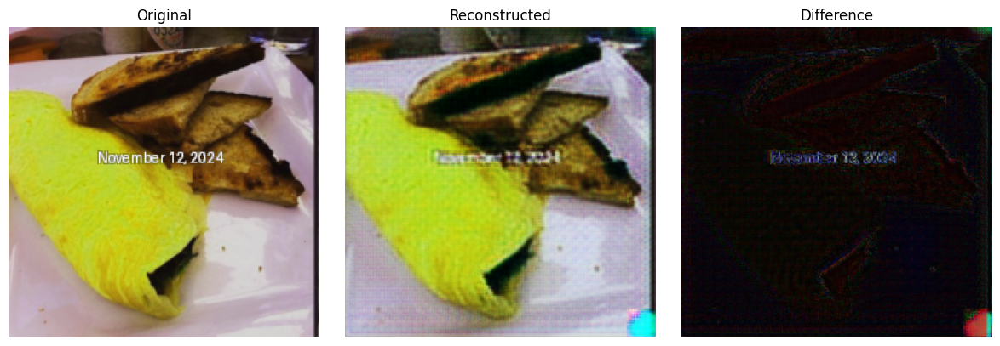

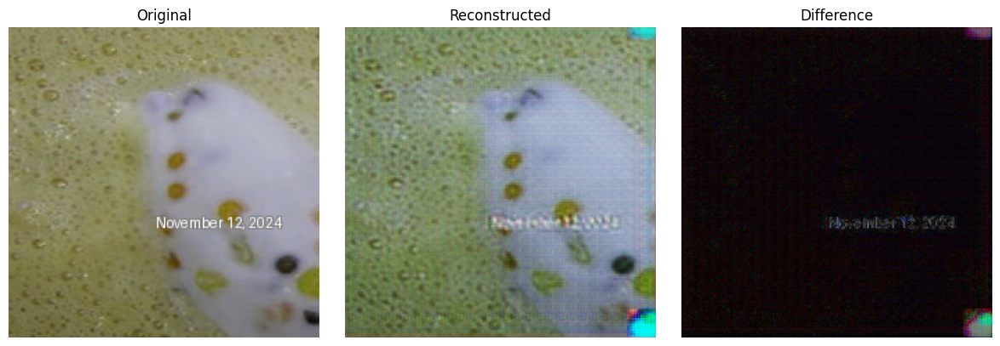

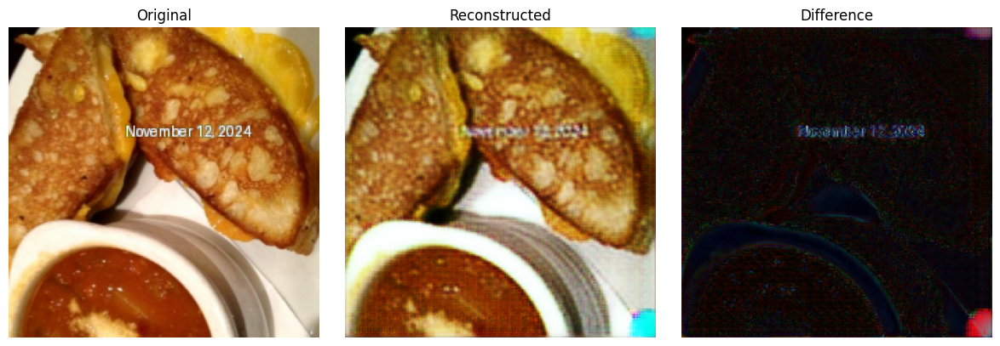

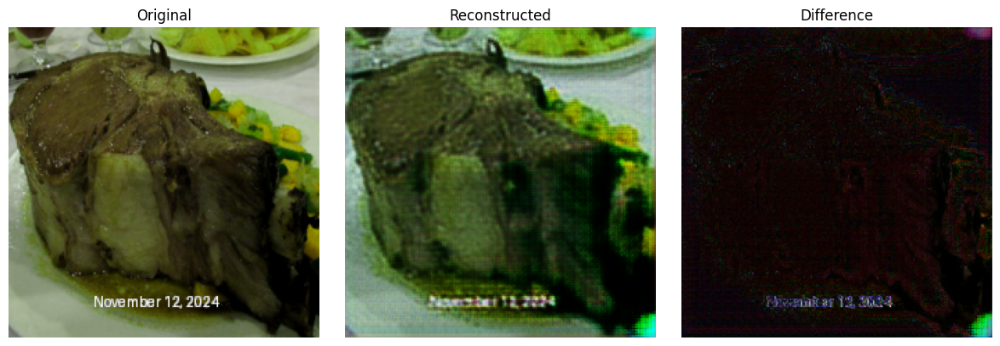

Epoch [172/200], Loss [D:  1.0825, G: 3348.4922]	LR [D: 0.000020, G: 0.000100]	Adv Weight: 0.15, Recon Weight: 0.85	Max Norm: 0.1793	[Duration:   40.77s, Elapsed: 00:05:32, Remaining: 02:13:03]  Checkpoint saved
Epoch [173/200], Loss [D:  0.9204, G: 3817.1312]	LR [D: 0.000020, G: 0.000100]	Adv Weight: 0.14, Recon Weight: 0.86	Max Norm: 0.1775	[Duration:   41.25s, Elapsed: 00:06:14, Remaining: 02:12:18]  Checkpoint saved
Epoch [174/200], Loss [D:  1.0170, G: 3106.2669]	LR [D: 0.000020, G: 0.000100]	Adv Weight: 0.14, Recon Weight: 0.86	Max Norm: 0.1757	[Duration:   41.04s, Elapsed: 00:06:55, Remaining: 02:11:29]  Checkpoint saved
Epoch [175/200], Loss [D:  1.0408, G: 3392.0579]	LR [D: 0.000020, G: 0.000100]	Adv Weight: 0.13, Recon Weight: 0.87	Max Norm: 0.1740	[Duration:   40.12s, Elapsed: 00:07:35, Remaining: 02:10:26]  Checkpoint saved
Epoch [176/200], Loss [D:  1.0842, G: 3371.1092]	LR [D: 0.000020, G: 0.000100]	Adv Weight: 0.12, Recon Weight: 0.88	Max Norm: 0.1722	[Duration:   40.46s

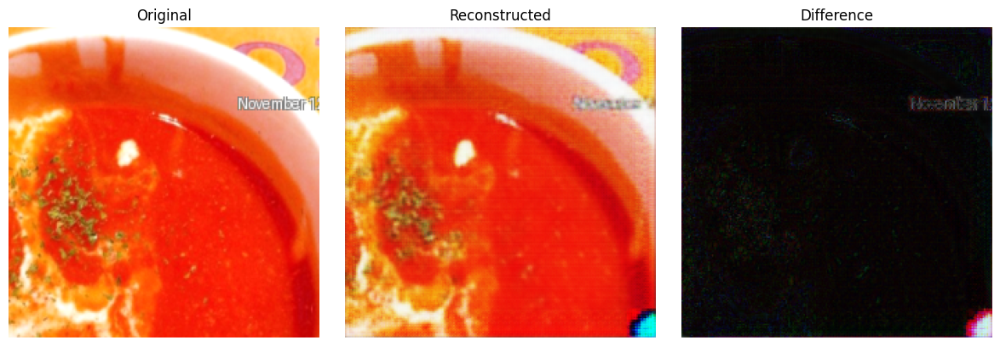

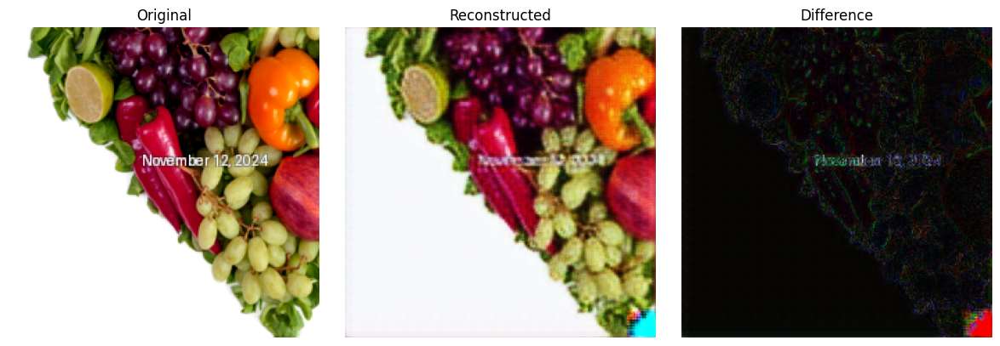

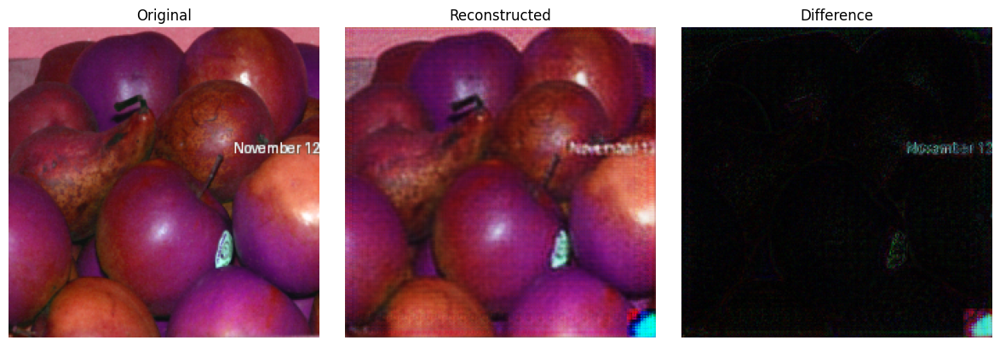

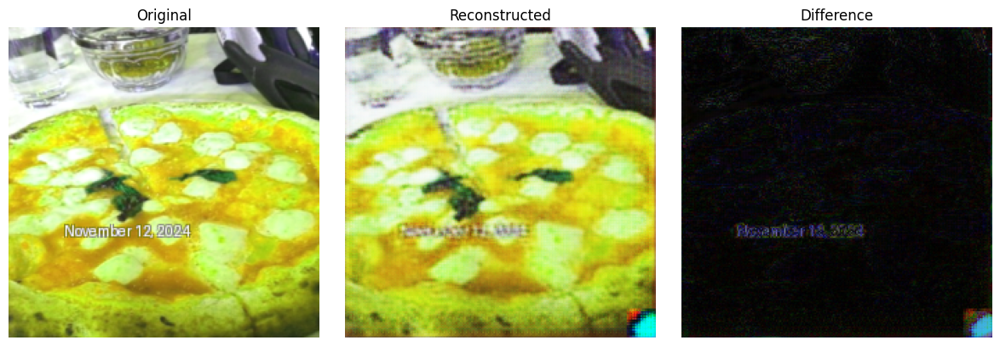

Epoch [182/200], Loss [D:  1.1983, G: 3667.5570]	LR [D: 0.000020, G: 0.000100]	Adv Weight: 0.09, Recon Weight: 0.91	Max Norm: 0.1622	[Duration:   41.18s, Elapsed: 00:12:24, Remaining: 02:05:27]  Checkpoint saved
Epoch [183/200], Loss [D:  0.9050, G: 3456.4697]	LR [D: 0.000020, G: 0.000100]	Adv Weight: 0.09, Recon Weight: 0.91	Max Norm: 0.1605	[Duration:   40.10s, Elapsed: 00:13:04, Remaining: 02:04:35]  Checkpoint saved
Epoch [184/200], Loss [D:  0.8517, G: 3608.5088]	LR [D: 0.000020, G: 0.000100]	Adv Weight: 0.08, Recon Weight: 0.92	Max Norm: 0.1589	[Duration:   40.21s, Elapsed: 00:13:45, Remaining: 02:03:45]  Checkpoint saved
Epoch [185/200], Loss [D:  0.9406, G: 3495.2364]	LR [D: 0.000020, G: 0.000100]	Adv Weight: 0.08, Recon Weight: 0.92	Max Norm: 0.1574	[Duration:   40.19s, Elapsed: 00:14:25, Remaining: 02:02:56]  Checkpoint saved
Epoch [186/200], Loss [D:  0.8292, G: 3650.6555]	LR [D: 0.000020, G: 0.000100]	Adv Weight: 0.07, Recon Weight: 0.93	Max Norm: 0.1558	[Duration:   40.12s

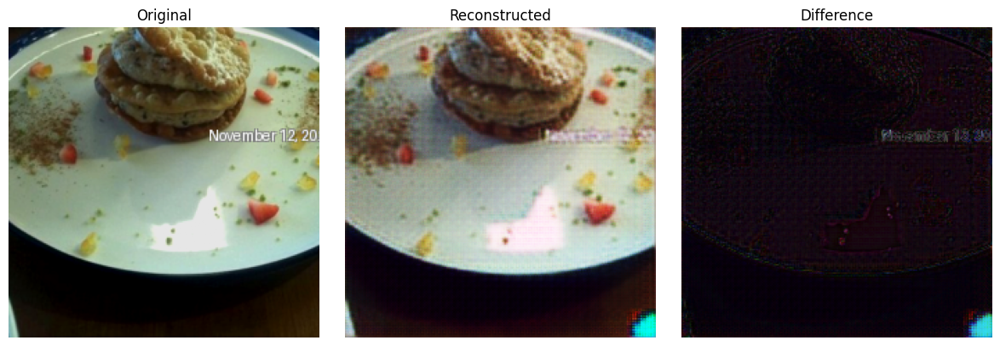

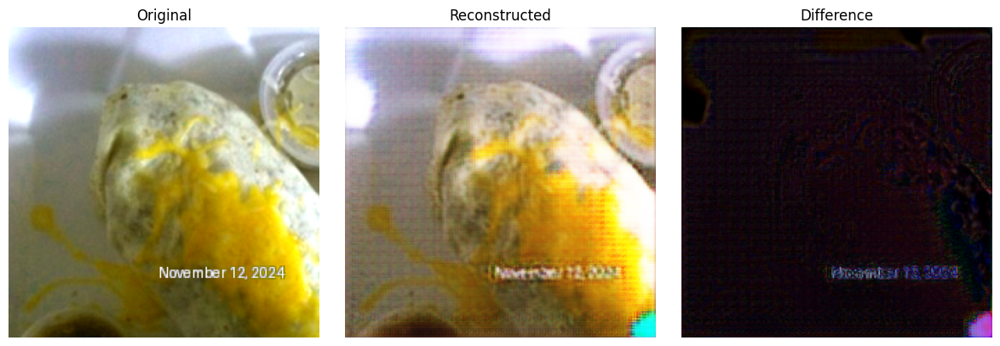

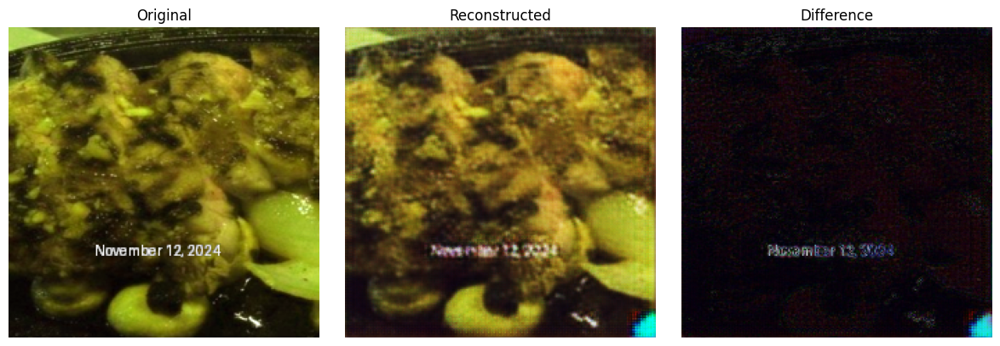

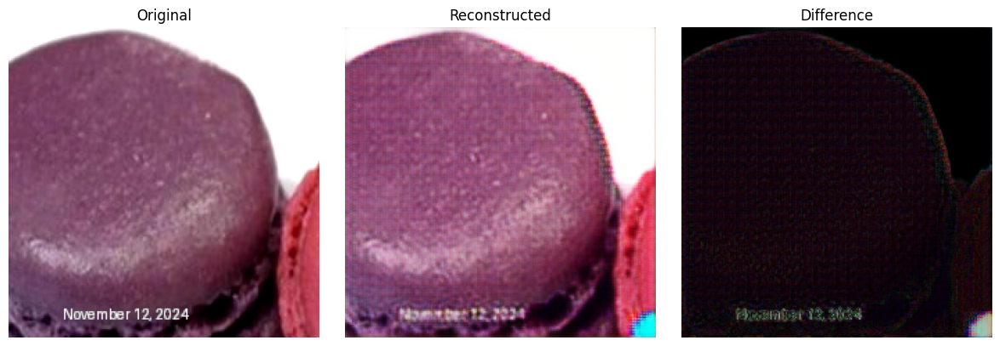

Epoch [192/200], Loss [D:  0.8331, G: 3287.4249]	LR [D: 0.000020, G: 0.000100]	Adv Weight: 0.05, Recon Weight: 0.95	Max Norm: 0.1467	[Duration:   38.93s, Elapsed: 00:19:04, Remaining: 01:57:13]  Checkpoint saved
Epoch [193/200], Loss [D:  0.8558, G: 3513.0985]	LR [D: 0.000020, G: 0.000100]	Adv Weight: 0.04, Recon Weight: 0.96	Max Norm: 0.1452	[Duration:   39.27s, Elapsed: 00:19:44, Remaining: 01:56:23]  Checkpoint saved
Epoch [194/200], Loss [D:  0.8961, G: 3608.4525]	LR [D: 0.000020, G: 0.000100]	Adv Weight: 0.04, Recon Weight: 0.96	Max Norm: 0.1437	[Duration:   39.01s, Elapsed: 00:20:23, Remaining: 01:55:33]  Checkpoint saved
Epoch [195/200], Loss [D:  0.8278, G: 3731.6527]	LR [D: 0.000020, G: 0.000100]	Adv Weight: 0.03, Recon Weight: 0.97	Max Norm: 0.1423	[Duration:   39.72s, Elapsed: 00:21:03, Remaining: 01:54:47]  Checkpoint saved
Epoch [196/200], Loss [D:  0.9742, G: 3670.4022]	LR [D: 0.000020, G: 0.000100]	Adv Weight: 0.03, Recon Weight: 0.97	Max Norm: 0.1409	[Duration:   38.12s

In [33]:
# Training loop
num_epochs = 200
model_path = "/mnt/b/Encoder"
model_name = "food11_stamp_kernel4_stride2_lossmse_maxnormdyn1_flip_224_64_128_256"
start_epoch = load_checkpoint(generator, discriminator, optimizer_G, optimizer_D, scaler, checkpoint_path=f"{model_path}/{model_name}_checkpoint.pth")

training_start_time = time.time()

for epoch in range(start_epoch, num_epochs):
    epoch_start_time = time.time()

    g_loss_epoch = 0
    d_loss_epoch = 0

    max_norm = get_dynamic_max_norm(epoch, initial_norm=1.0, decay_factor=0.99, min_norm=0.1)

    # "Dynamic" weighting for loss functions (Try swicthing them later)
    #lambda_adv = epoch / num_epochs
    #lambda_rec = 1 - lambda_adv
    lambda_rec = epoch / num_epochs
    lambda_adv = 1 - lambda_rec
    

    for stamped_imgs, original_imgs, _ in train_loader:
        stamped_imgs, original_imgs = stamped_imgs.to(device), original_imgs.to(device)

        # ========================
        # Train Discriminator
        # ========================
        optimizer_D.zero_grad()

        with torch.autocast(device_type='cuda', dtype=torch.float16, enabled=use_amp):
            # Generate fake images
            fake_imgs = generator(stamped_imgs)

            # Prepare inputs for the discriminator
            real_input = torch.cat([original_imgs, stamped_imgs], dim=1)
            fake_input = torch.cat([fake_imgs.detach(), stamped_imgs], dim=1)

            # Labels for real and fake images
            real_labels = torch.ones(original_imgs.size(0), 1).to(device)
            fake_labels = torch.zeros(original_imgs.size(0), 1).to(device)

            # Compute discriminator losses
            real_loss = adversarial_loss(discriminator(real_input), real_labels)
            fake_loss = adversarial_loss(discriminator(fake_input), fake_labels)
            d_loss = (real_loss + fake_loss) / 2
            # gradient_penalty = compute_gradient_penalty(discriminator, original_imgs, fake_imgs, stamped_imgs)
            # d_loss += gradient_penalty  # Lambda for regularization    

        # Update discriminator
        scaler.scale(d_loss).backward()
        scaler.unscale_(optimizer_D)
        torch.nn.utils.clip_grad_norm_(discriminator.parameters(), max_norm=max_norm)
        scaler.step(optimizer_D)
        scaler.update()

        d_loss_epoch += d_loss.item()

        # ========================
        # Train Generator
        # ========================
        optimizer_G.zero_grad()

        with torch.autocast(device_type='cuda', dtype=torch.float16, enabled=use_amp):
            # Generate fake images
            fake_imgs = generator(stamped_imgs)

            # Prepare inputs for the discriminator
            fake_input = torch.cat([fake_imgs, stamped_imgs], dim=1)

            # Compute generator losses
            #g_loss_adv = adversarial_loss(discriminator(fake_input), real_labels)
            #g_loss_perceptual = perceptual_loss_vgg(original_imgs, fake_imgs, perceptual_loss_model, imagenet_std, imagenet_mean)
            #g_rec_loss = reconstruction_loss(fake_imgs, original_imgs)
            g_rec_loss = reconstruction_loss(discriminator(fake_input), real_labels)
            #g_dissimilarity = dissimilarity_loss(original_imgs, fake_imgs)

            # Total generator loss
            #g_loss = (g_loss_adv + g_rec_loss) / 2
            g_loss = g_rec_loss
            # Weighted total generator loss
            #g_loss = lambda_adv * g_loss_adv + lambda_rec * g_rec_loss
            # Alternating loss
            # if epoch % 2 == 0:
            #     g_loss = g_dissimilarity
            # else:
            #     g_loss = reconstruction_loss(discriminator(fake_input), real_labels)

        # Update generator
        scaler.scale(g_loss).backward()
        scaler.unscale_(optimizer_G)
        torch.nn.utils.clip_grad_norm_(generator.parameters(), max_norm=max_norm)
        scaler.step(optimizer_G)
        scaler.update()

        g_loss_epoch += g_loss.item()
    
    # ========================
    # Scheduler Step
    # ========================
    # scheduler_G.step(g_loss_epoch)
    # scheduler_D.step(d_loss_epoch)

    # ========================
    # Logging
    # ========================
    epoch_end_time = time.time()
    epoch_duration = epoch_end_time - epoch_start_time
    elapsed_time = epoch_end_time - training_start_time
    estimated_total_time = elapsed_time / (epoch - start_epoch + 1) * num_epochs
    estimated_remaining_time = estimated_total_time - elapsed_time

    # Format times
    elapsed_hours, elapsed_remainder = divmod(elapsed_time, 3600)
    elapsed_minutes, elapsed_seconds = divmod(elapsed_remainder, 60)
    remaining_hours, remaining_remainder = divmod(estimated_remaining_time, 3600)
    remaining_minutes, remaining_seconds = divmod(remaining_remainder, 60)

    print(
        f"Epoch [{epoch+1:03d}/{num_epochs:03d}], "
        f"Loss [D: {d_loss_epoch:7.4f}, G: {g_loss_epoch:7.4f}]\t"
        f"LR [D: {optimizer_D.param_groups[0]['lr']:.6f}, G: {optimizer_G.param_groups[0]['lr']:.6f}]\t"
        f"Adv Weight: {lambda_adv:.2f}, Recon Weight: {lambda_rec:.2f}\t"
        f"Max Norm: {max_norm:6.4f}\t"
        f"[Duration: {epoch_duration:7.2f}s, "
        f"Elapsed: {str(int(elapsed_hours)).zfill(2)}:"
        f"{str(int(elapsed_minutes)).zfill(2)}:"
        f"{str(int(elapsed_seconds)).zfill(2)}, "
        f"Remaining: {str(int(remaining_hours)).zfill(2)}:"
        f"{str(int(remaining_minutes)).zfill(2)}:"
        f"{str(int(remaining_seconds)).zfill(2)}] ",
        end=" "
    )

    # Save a checkpoint every epoch
    save_checkpoint(generator, discriminator, optimizer_G, optimizer_D, scaler, epoch, checkpoint_path=f"{model_path}/{model_name}_checkpoint.pth")

    # Display generated images every 10 epochs
    if epoch % 10 == 0:
        generator.eval()
        with torch.no_grad():
            for i in range(4):  # Display samples
                plot_images(stamped_imgs[i].cpu(), fake_imgs[i].cpu(), display=True, save_path=f"{model_path}/plots/{model_name}_epoch{epoch}_sample{i}.png")
        generator.train()

# ========================
# Save Final Models
# ========================
final_model_path = f"{model_path}/models/{model_name}_final_D_{d_loss_epoch:.4f}_G_{g_loss_epoch:.4f}.pth"
torch.save({
    "generator_state_dict": generator.state_dict(),
    "discriminator_state_dict": discriminator.state_dict(),
    "optimizer_G_state_dict": optimizer_G.state_dict(),
    "optimizer_D_state_dict": optimizer_D.state_dict(),
    "d_loss": d_loss_epoch,
    "g_loss": g_loss_epoch,
}, final_model_path)

print(f"\nFinal models saved at: {final_model_path}")

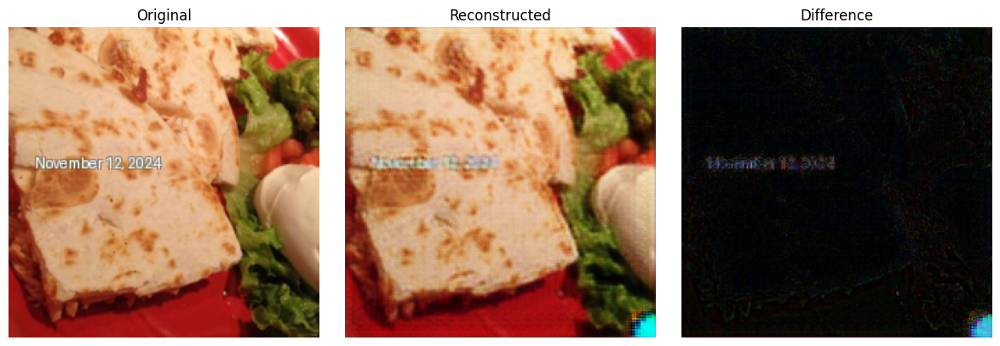

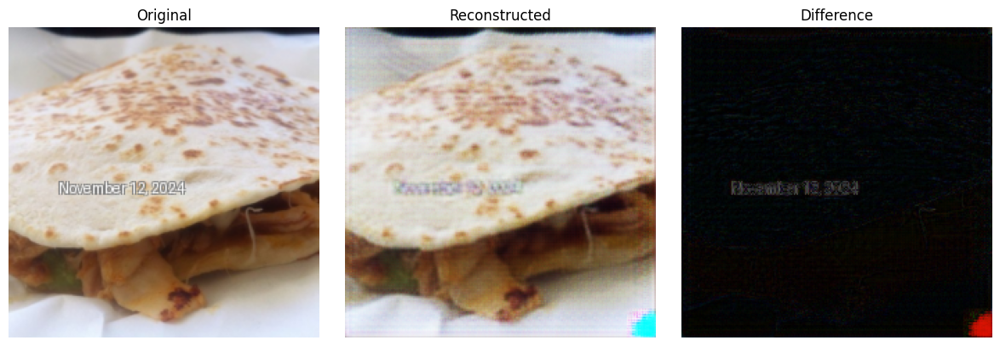

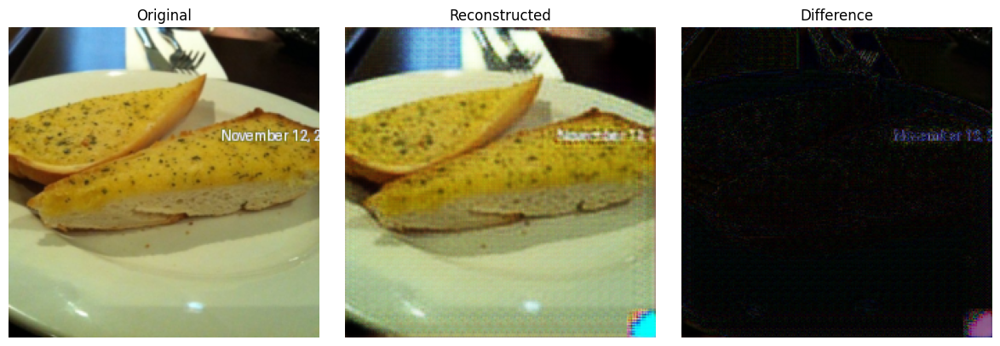

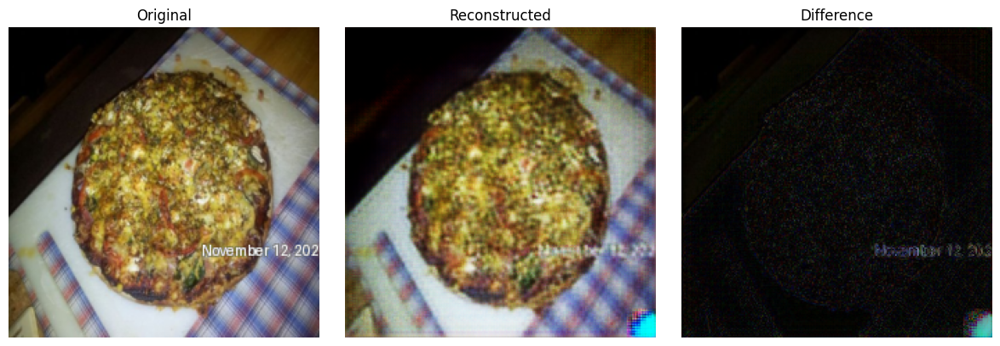

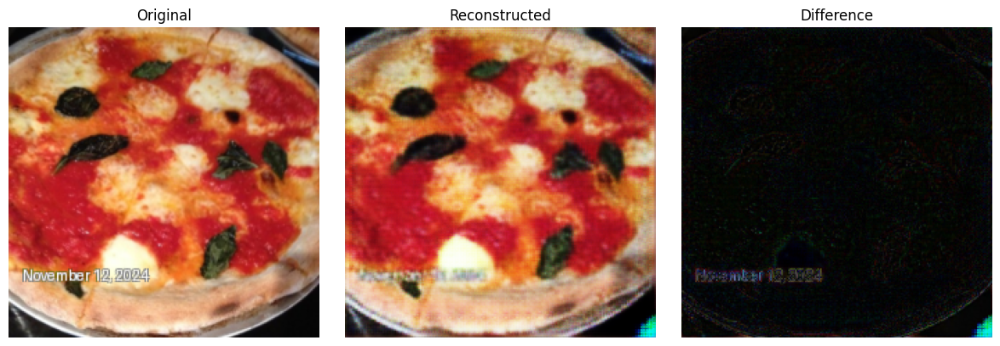

...

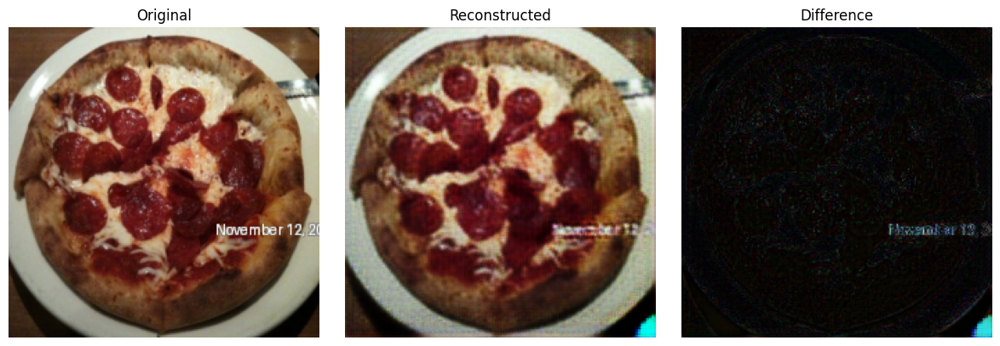

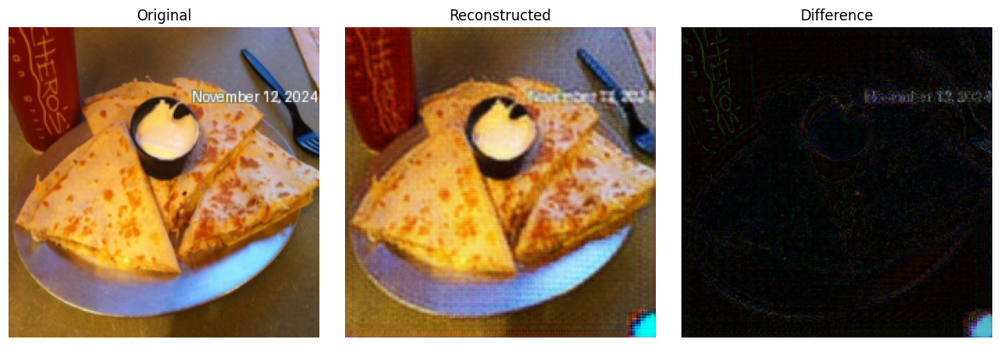

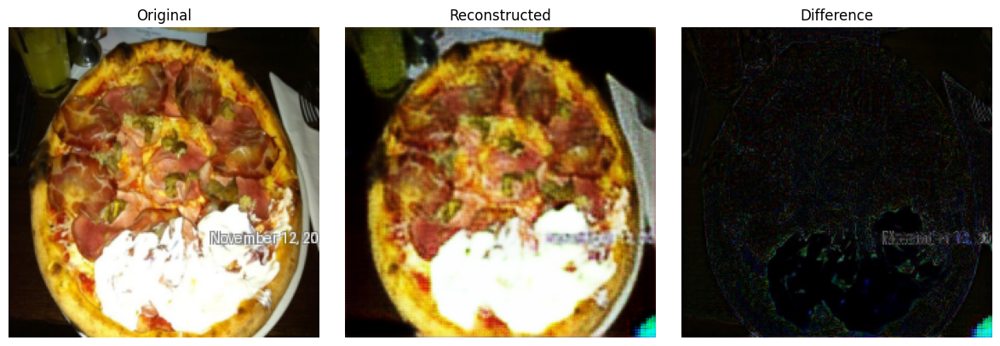

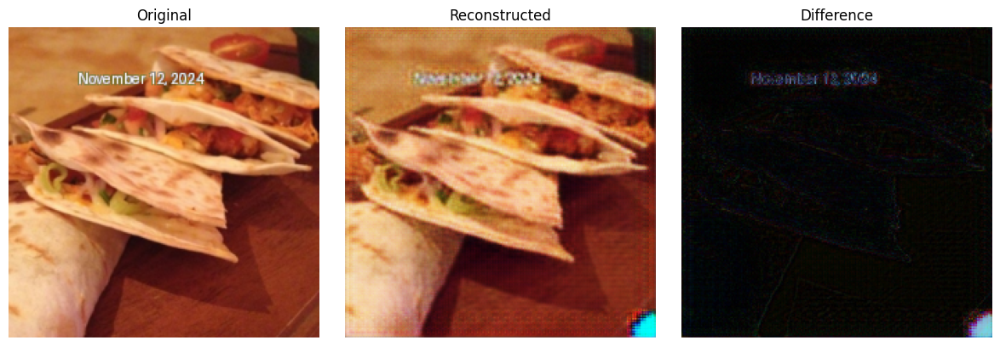

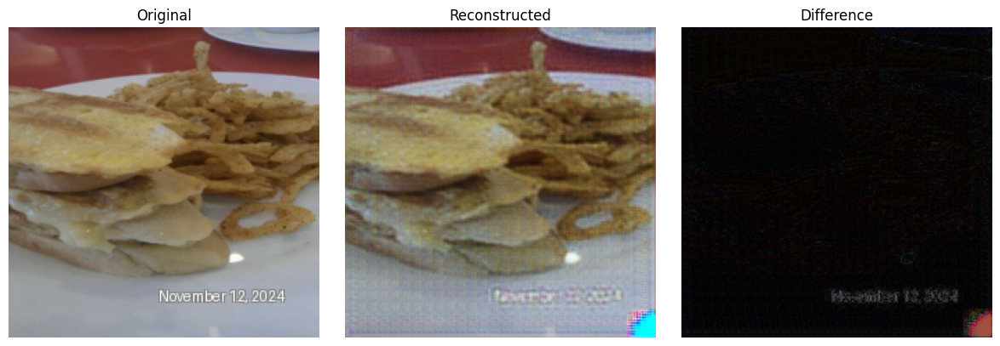

IndexError: index 16 is out of bounds for dimension 0 with size 16

In [34]:
# Load a batch of images and display the original and reconstructed images
# model_to_load = "/mnt/b/Encoder/models/food11_stamp_kernel4_stride2_lossmse_maxnormdyn1_flip_224_64_128_256_512_final_D_3.3567_G_0.0614.pth"
# generator = Generator(input_channels=3, hidden_dims=[64, 128, 256, 512], kernel_size=4, stride=2, leaky_relu_slope=0.2, norm_type="batch")
# generator = generator.to(device)
# model = generator.load_state_dict(torch.load(model_to_load, weights_only=True)["generator_state_dict"])
data_iter = iter(test_loader)
stamped_images, base_images, _ = next(data_iter)
stamped_images = stamped_images.to(device)
base_images = base_images.to(device)
with torch.no_grad():
    outputs = generator(stamped_images)
  

for i in range(20):
    plot_images(stamped_images[i].cpu(), outputs[i].cpu())



## 5.1 Model Selection
<!--
- Choose the model(s) to be trained (e.g., linear regression, decision trees, neural networks).
-->

## 5.2 Model Training
<!--
- Train the selected model(s) using the training data.
-->

## 5.3 Model Evaluation
<!--
- Evaluate model performance on validation data.
- Use appropriate metrics (e.g., accuracy, precision, recall, RMSE).
-->

## 5.4 Hyperparameter Tuning
<!--
- Fine-tune the model using techniques like Grid Search or Random Search.
- Evaluate the impact of different hyperparameters.
-->

## 5.5 Model Testing
<!--
- Evaluate the final model on the test dataset.
- Ensure that the model generalizes well to unseen data.
-->

## 5.6 Model Interpretation (Optional)
<!--
- Interpret the model results (e.g., feature importance, SHAP values).
- Discuss the strengths and limitations of the model.
-->

---

# 6. Predictions


## 6.1 Make Predictions
<!--
- Use the trained model to make predictions on new/unseen data.
-->

## 6.2 Save Model and Results
<!--
- Save the trained model to disk for future use.
- Export prediction results for further analysis.
-->

---

# 7. Documentation and Reporting

## 7.1 Summary of Findings
<!--
- Summarize the results and findings of the analysis.
-->

## 7.2 Next Steps
<!--
- Suggest further improvements, alternative models, or future work.
-->

## 7.3 References
<!--
- Cite any resources, papers, or documentation used.
-->